In [109]:
import numpy as np
import cv2
import imutils
import os
import matplotlib.pyplot as plt

In [110]:
# !pip install imutils

In [174]:
PATH = os.path.dirname(os.path.abspath('.')) + '\data\\'
# img_path = '\data\\'
img_name= 'img6.jpg'

img = cv2.imread(PATH+img_name)
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

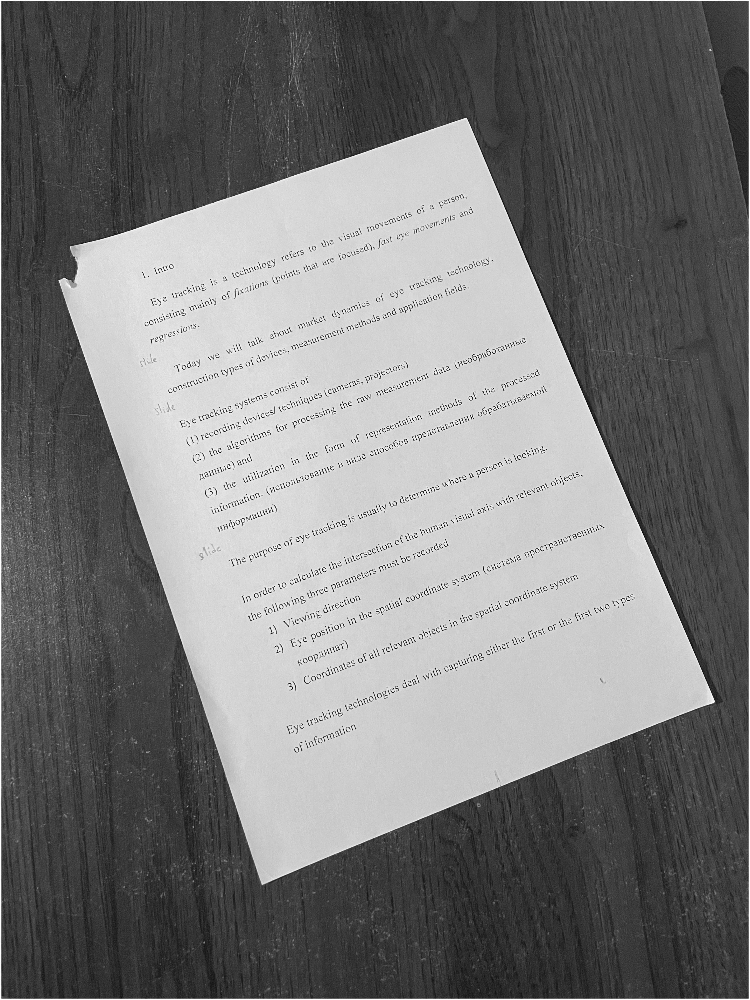

In [175]:
def display(im_data):
    dpi = 60
#     im_data = plt.imread(im_path)
    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()
    
display(img)

In [176]:
# img_ = imutils.resize(img, width=1000)
# display(img_)

new shape:  1800 1350


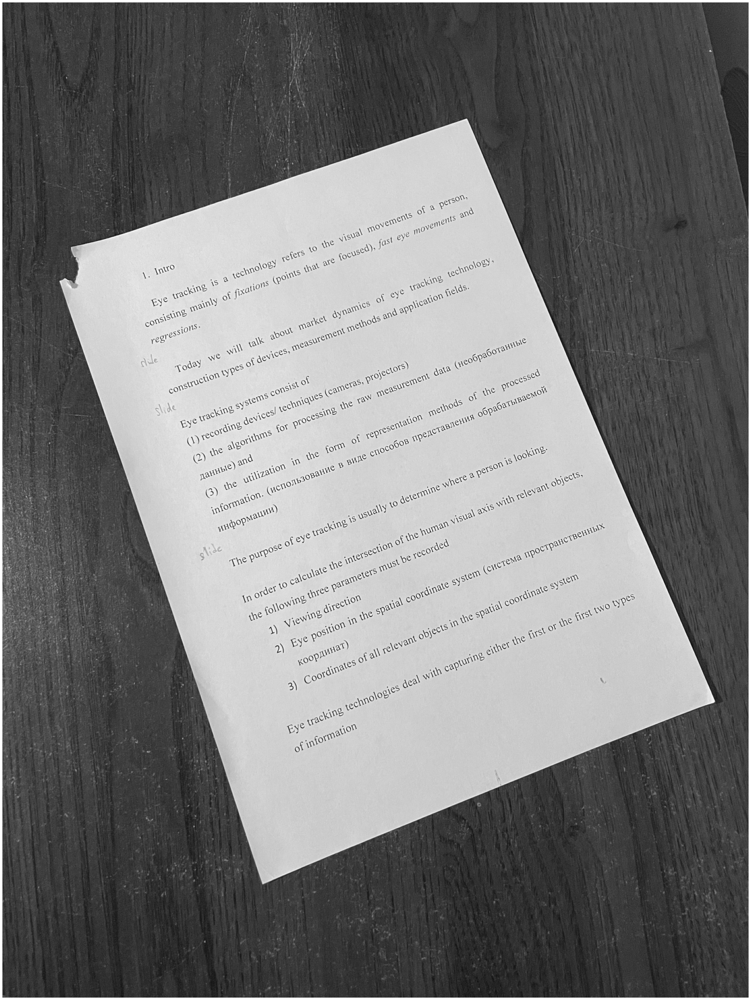

In [177]:
def resize(image, newHeight=None, newWidth=None):
    dim = None
    h, w = image.shape[:2]

    if newWidth is None and newHeight is None:
        return image

    if (newWidth is None) or (h > w):
        r = newHeight / float(h)
        dim = (int(w * r), newHeight)

    if (newHeight is None) or (h <= w):
        r = newWidth / float(w)
        dim = (newWidth, int(h * r))
    print('new shape: ', dim[1], dim[0])

#     return cv2.resize(img, dim, interpolation=cv2.INTER_CUBIC)
    return imutils.resize(image, width=dim[1])

img_ = resize(img, newHeight=1800, newWidth=1800)
display(img_)

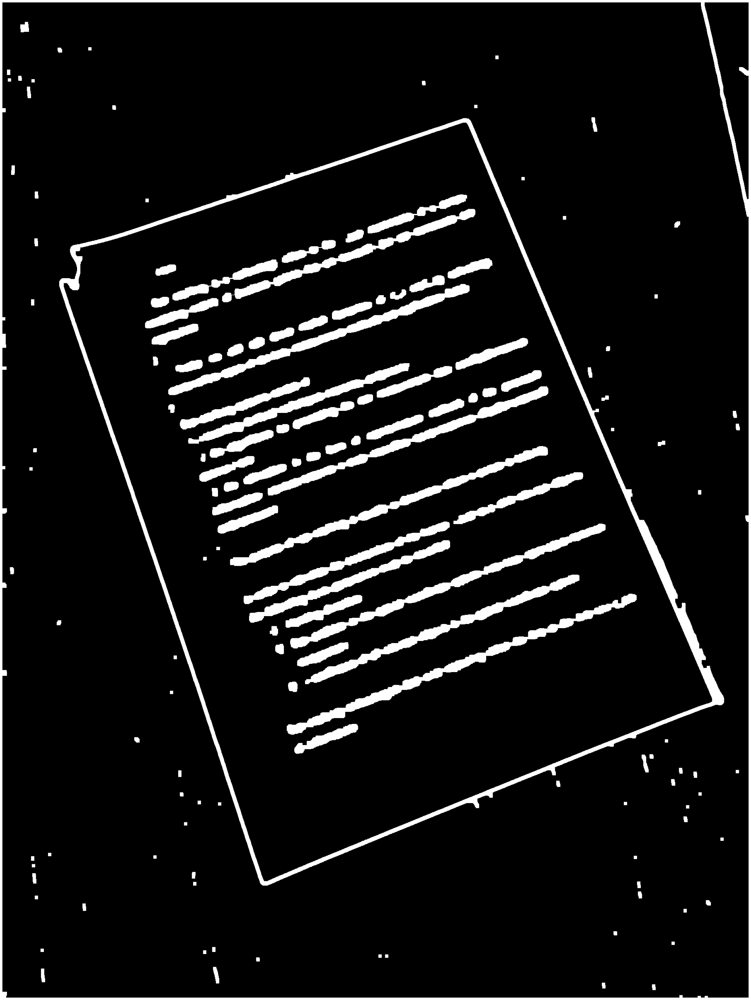

In [196]:
def preprocess1(image):
#     greyImg = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
#     img = cv2.bilateralFilter(image, 13, 75, 75)
    img = cv2.GaussianBlur(image, (5, 5), 3)
    
#     img = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 151, 10)

    img = cv2.medianBlur(img, 15)
    
    imgCanny = cv2.Canny(img, 40, 40)

    kern = np.ones((8, 8))

    imgDilate = cv2.dilate(imgCanny, kernel=kern, iterations=2)
    imgErode = cv2.erode(imgDilate, kernel=kern, iterations=1)

    return imgErode

proc_img1 = preprocess1(img_)
display(proc_img1)

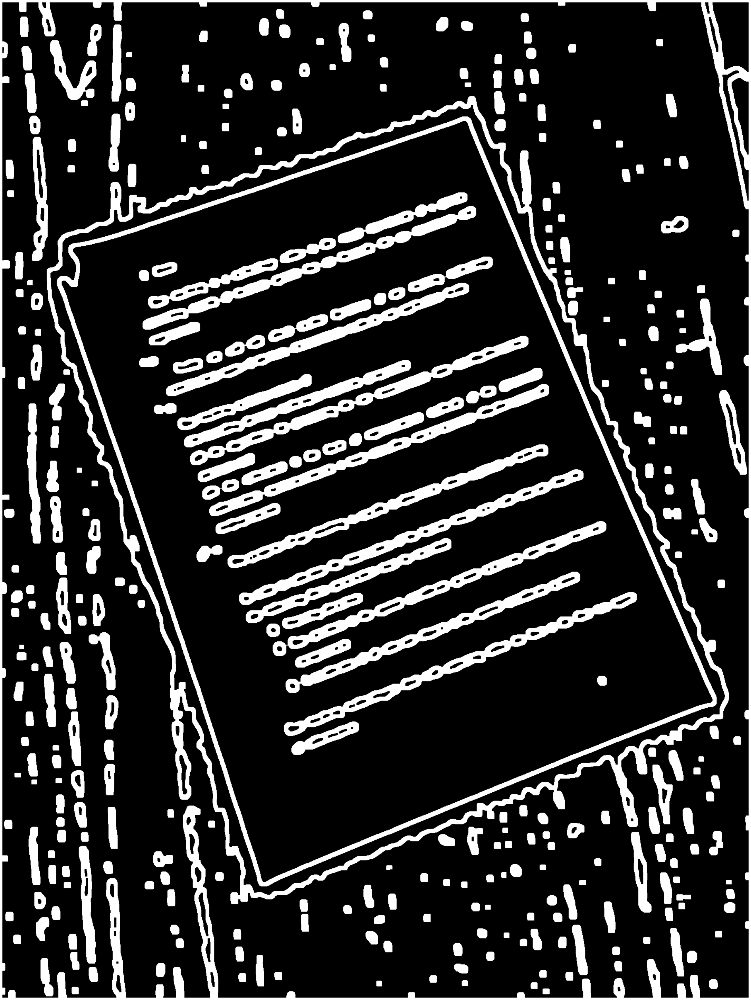

In [180]:
def preprocess2(image):
#     img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

#     img = cv2.bilateralFilter(img, 9, 75, 75)
    img = cv2.GaussianBlur(image, (27, 27), 5)

    # Create black and white image based on adaptive threshold
    img = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 115, 4)
#     img = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    #
    # # Median filter clears small details
    img = cv2.medianBlur(img,15)

    # Add black border in case that page is touching an image border
#     img = cv2.copyMakeBorder(img, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=[0, 0, 0])


    img = cv2.Canny(img, 50, 50)

    kern = np.ones((5, 5))

    imgDilate = cv2.dilate(img, kernel=kern, iterations=3)
    imgErode = cv2.erode(imgDilate, kernel=kern, iterations=1)


    return imgErode


proc_img2 = preprocess2(img_)
display(proc_img2)

In [181]:
def cropByContour(contour, image, defaultImage):
    mask = np.zeros_like(image)
    cv2.drawContours(mask, contour, -1, (255, 0, 0), -1)
#     display(mask)
    out = np.zeros_like(image)
    out[mask == 255] = image[mask == 255]
    
    (y, x) = np.where(mask == 255)
#     print(np.where(mask == 255))
    (topy, topx) = (np.min(y), np.min(x))
    (bottomy, bottomx) = (np.max(y), np.max(x))
    out = defaultImage[topy:bottomy+1, topx:bottomx+1]
    display(out)
    
    return out

def cropByContour_(contour, image, defaultImage):
    mask = np.zeros_like(image)
    mask = cv2.fillConvexPoly(mask, contour, (255))
#     display(mask)
    blend_mask = mask * image
#     display(blend_mask)
    
    return blend_mask


def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
#     gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
#     blur = cv2.GaussianBlur(gray, (9, 9), 0)
#     thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    
#     kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
#     dilate = cv2.dilate(thresh, kernel, iterations=2)
#     display(dilate)
    
#     img = cv2.bilateralFilter(gray, 9, 75, 75)
    img = cv2.GaussianBlur(newImage, (15, 15), 5)

    # Create black and white image based on adaptive threshold
    img = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 115, 4)
#     img = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    #
    # # Median filter clears small details
    # img = cv2.medianBlur(img, 25)

    # Add black border in case that page is touching an image border
#     img = cv2.copyMakeBorder(img, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=[0, 0, 0])


    img = cv2.Canny(img, 50, 50)

    kern = np.ones((3, 3))
#     kern = cv2.getStructuringElement(cv2.MORPH_RECT, (50, 7))
    imgDilate = cv2.dilate(img, kernel=kern, iterations=2)
    imgErode = cv2.erode(imgDilate, kernel=kern, iterations=1)
    
    print('1 Erode')
    display(imgErode)
    
    
    # Find all contours
    contours, hierarchy = cv2.findContours(imgErode, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_NONE) #RETR_LIST
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)
#     display(newImage)
    # Find largest contour and surround in min area box
    largestContour = contours[0]
    cv2.drawContours(imgErode, largestContour, -1, (255, 0, 0), 20)
    print('2 Erode with contour')
    display(imgErode)
    
    cropped_img = cropByContour_(largestContour, imgErode, newImage)
    print('3 Cropped')
    display(cropped_img)
    
    contours, hierarchy = cv2.findContours(cropped_img, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE) #RETR_LIST
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(cropped_img,(x,y),(x+w,y+h),(100,255,0),2)
    
    print('4 Cropped')
    display(cropped_img)
    
#     print (len(contours))
#     min_cont = 10
#     max_cont = 50
#     angle_arr = np.empty(max_cont-min_cont)
    contours=contours[20:50]
    angle_arr = np.empty(len(contours))
    for i, contour in enumerate(contours):
        minAreaRect = cv2.minAreaRect(contour)
        # Determine the angle. Convert it to the value that was originally used to obtain skewed image
        angle_arr[i] = minAreaRect[-1]
#     plt.hist(angle_arr)
    angle = angle_arr.mean()
#     print(angle)
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle

# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [182]:
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    print('Angle: ', angle)
    return rotateImage(cvImage, -1.0 * angle)

1 Erode


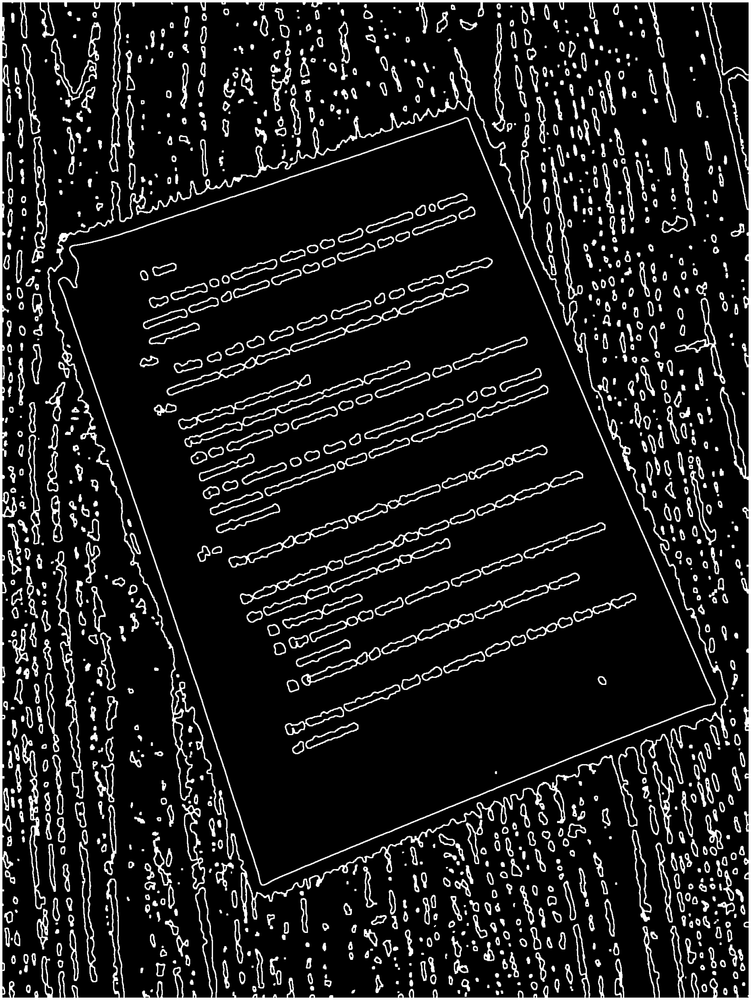

2 Erode with contour


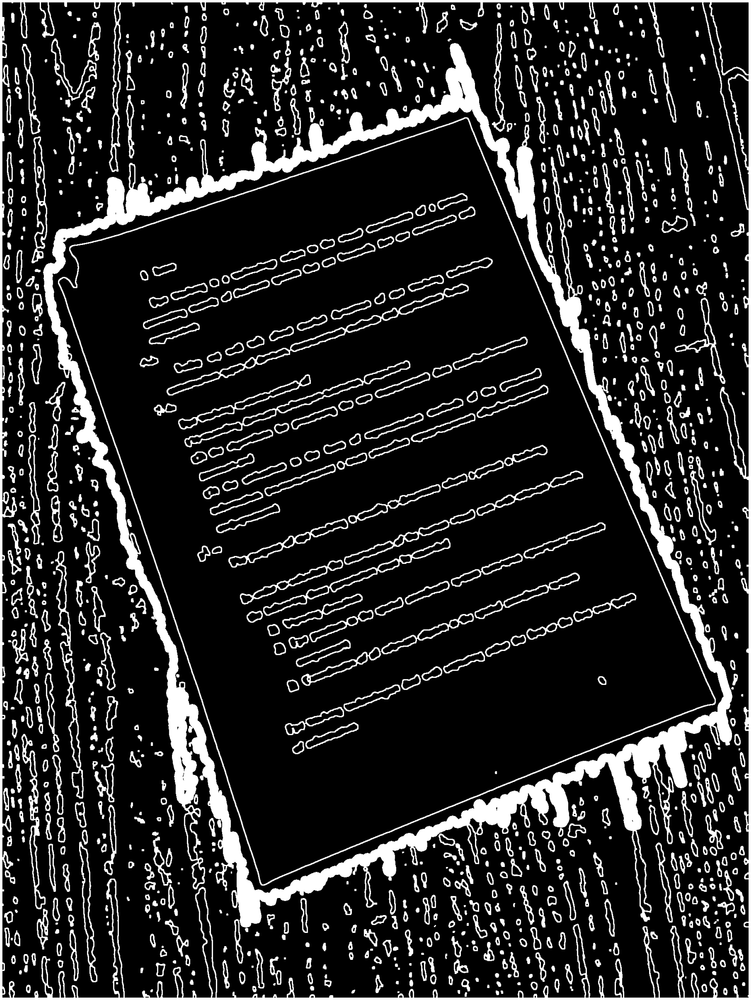

3 Cropped


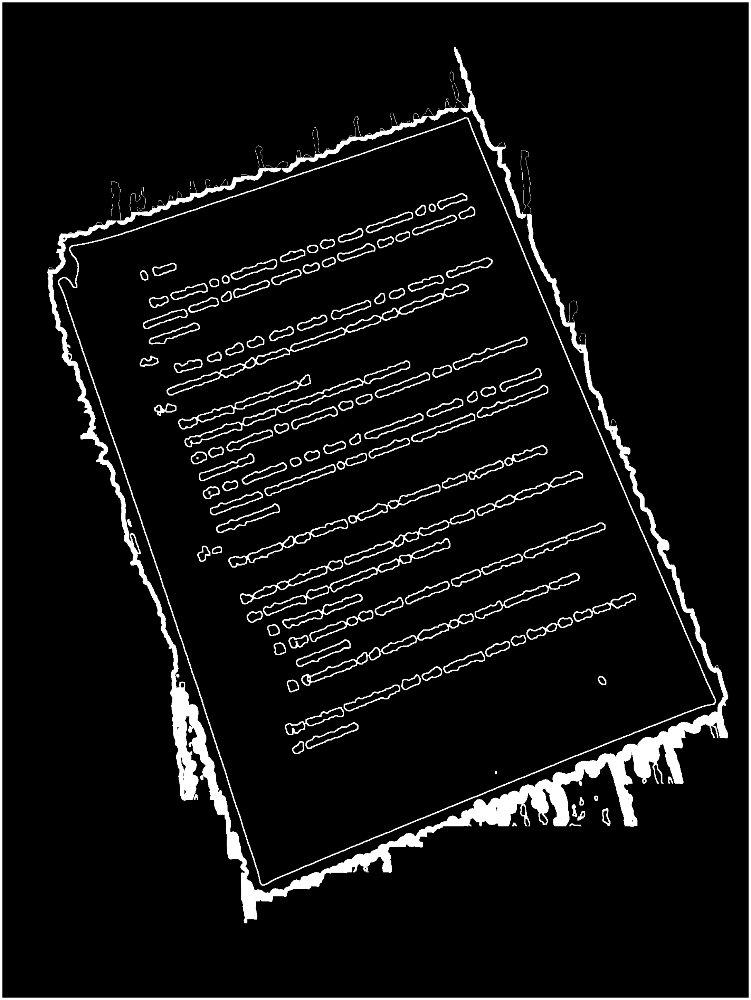

4 Cropped


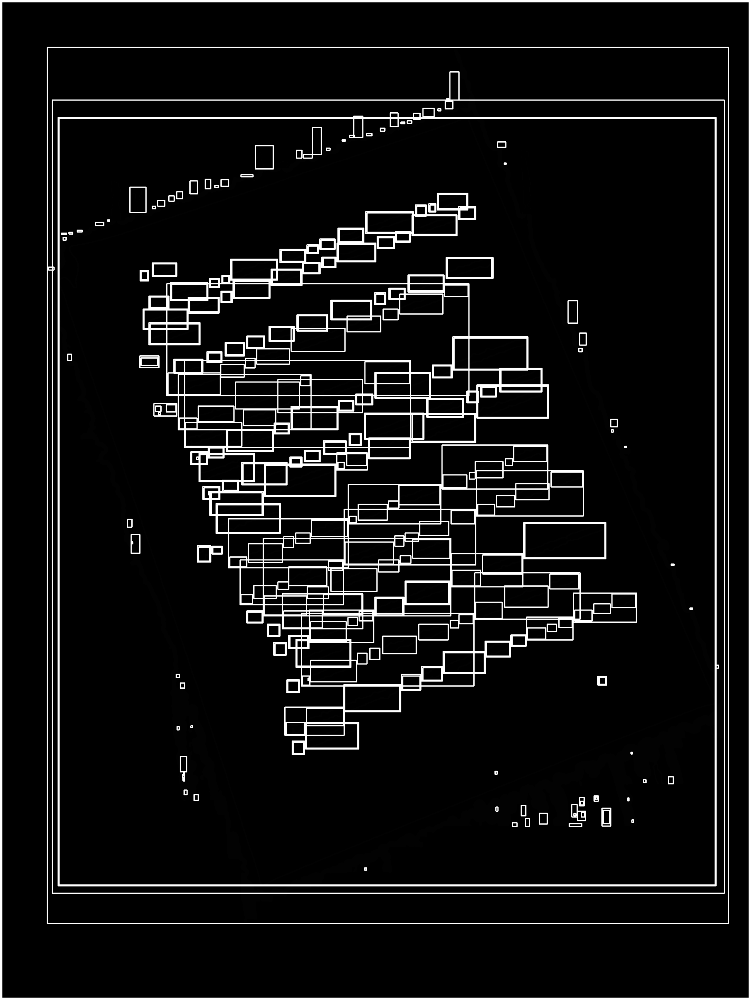

Angle:  -70.0150545756022


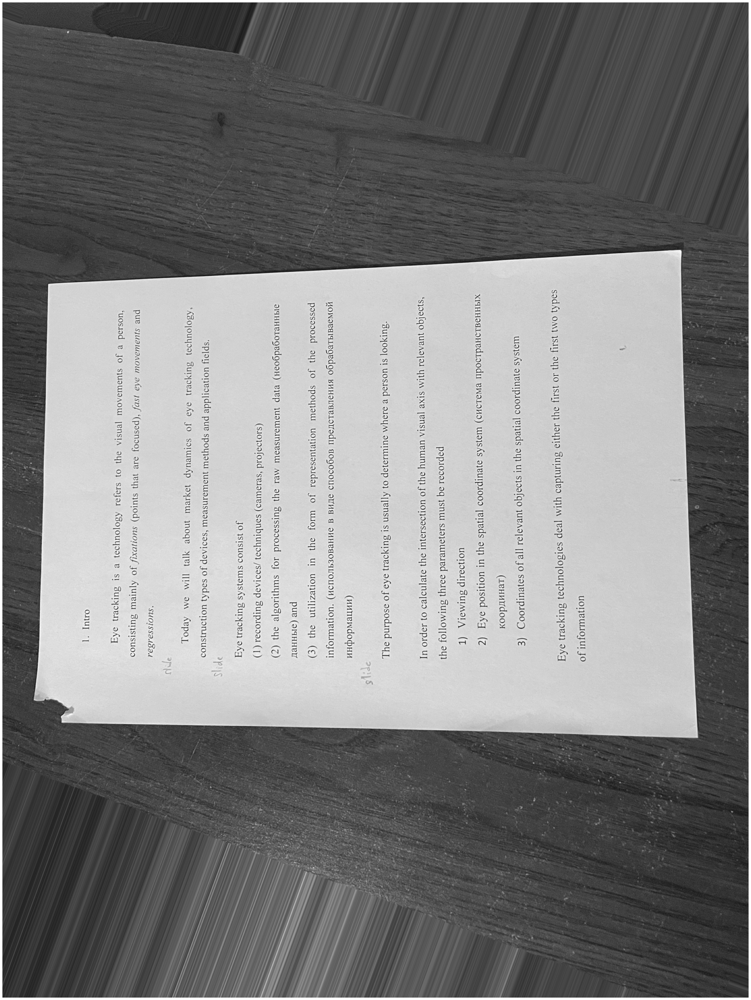

In [183]:
fixed = deskew(img_)
display(fixed)

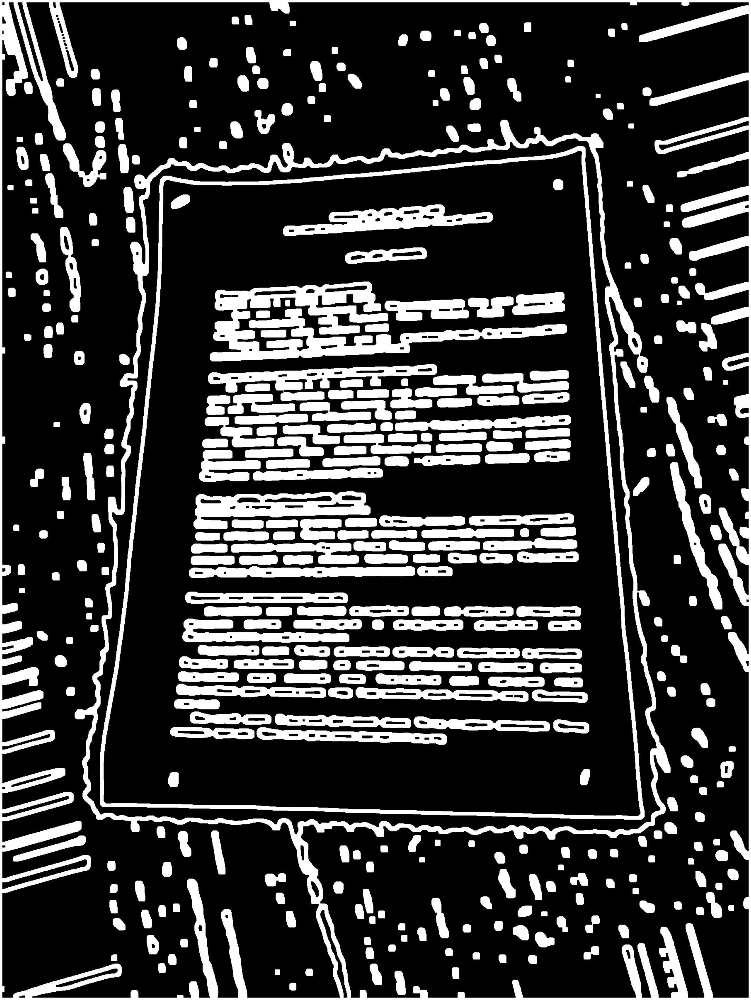

In [138]:
proc_fixed = preprocess2(fixed)
display(proc_fixed)

In [167]:
def get_contours(image, defaultImage):
    defaultImage_ = defaultImage.copy()
    
    biggestContour, maxArea = None, None
    contours, hierarchy = cv2.findContours(image, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

    contArea = [cv2.contourArea(contour) for contour in contours]

    sortedContoursAndArea = [(c, a) for c, a in sorted(zip(contours, contArea),
                                                       key=lambda pair: pair[1],
                                                       reverse=True)]

    # sortedContours, sortedArea = list(zip(*sortedContoursAndArea))
    # print(sortedArea)

    for contour, area in sortedContoursAndArea:
        perimeter = cv2.arcLength(contour, True)
        approx = cv2.approxPolyDP(contour, 0.005 * perimeter, True)
        if area >= 7000 and len(approx) == 4:
            biggestContour = approx
            maxArea = area
            break

    print('Biggest contour: ', biggestContour, '\nArea: ', maxArea)
    
#     (x, y, w, h) = cv2.boundingRect(biggestContour)
    
#     print(w, h, w/h)
    
    cv2.drawContours(defaultImage_, biggestContour, -1, (255, 0, 0), 20)
    
    display(defaultImage_)

    return biggestContour

Biggest contour:  [[[1404  349]]

 [[ 382  424]]

 [[ 240 1939]]

 [[1547 1965]]] 
Area:  1797683.0


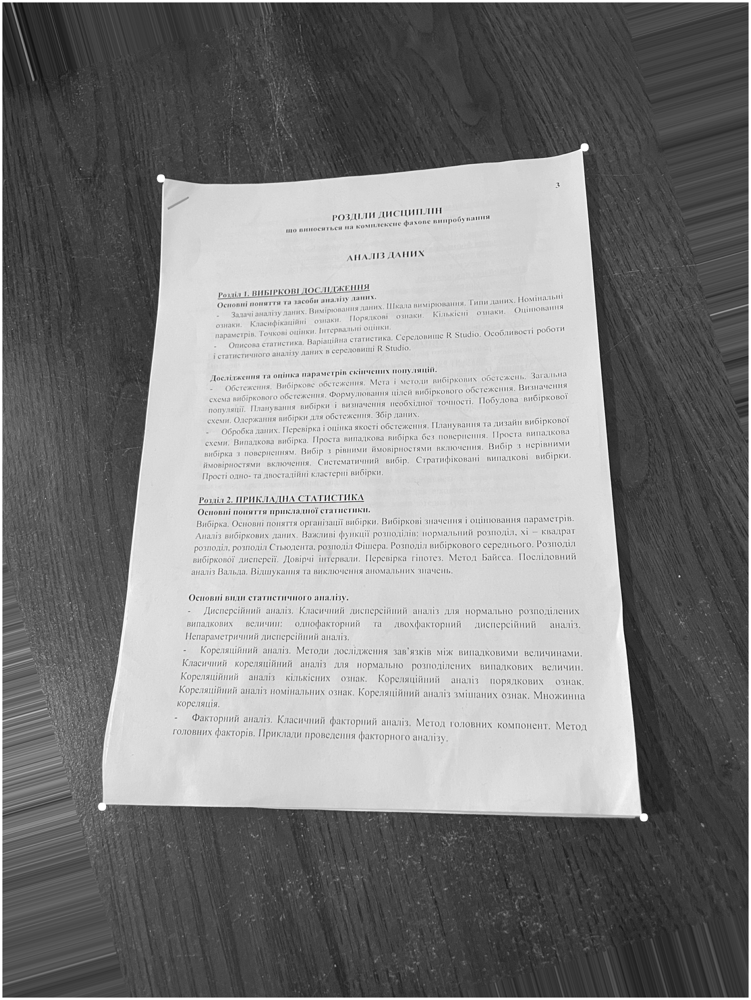

In [168]:
fixed_contour = get_contours(proc_fixed, fixed)
# display(fixed_cont)

In [169]:
# fixed_contour = get_contours(proc_fixed, fixed)

In [170]:
# display(fixed)

In [171]:
np.dot(3, [3,4])

array([ 9, 12])

In [172]:
def reorderPoints(points):
    points = points.reshape((4, 2))
    pointsNew = np.zeros((4, 1, 2), np.int32)
    summa = points.sum(axis=1)
    pointsNew[0] = points[np.argmin(summa)]
    pointsNew[3] = points[np.argmax(summa)]

    diff = np.diff(points, axis=1)
    pointsNew[1] = points[np.argmin(diff)]
    pointsNew[2] = points[np.argmax(diff)]

    return pointsNew


def getWarp(img, biggestContour):
    biggestContourReord = reorderPoints(biggestContour)

    (tl, tr, br, bl) = biggestContourReord.reshape((4, 2))

    widthA = np.sqrt((tl[0] - tr[0]) ** 2 + (tl[1] - tr[1]) ** 2)
    widthB = np.sqrt((bl[0] - br[0]) ** 2 + (bl[1] - br[1]) ** 2)
    maxWidth = max(int(widthA), int(widthB))

    heightA = np.sqrt((tl[0] - bl[0]) ** 2 + (tl[1] - bl[1]) ** 2)
    heightB = np.sqrt((tr[0] - br[0]) ** 2 + (tr[1] - br[1]) ** 2)
    maxHeight = max(int(heightA), int(heightB))

    points1 = np.float32(biggestContourReord)
    points2 = np.float32([[-7, -7], [maxWidth + 7, -7], [-7, maxHeight + 7], [maxWidth +7, maxHeight + 7]])

    matrix = cv2.getPerspectiveTransform(points1, points2)
    warpedImg = cv2.warpPerspective(img, matrix, (maxWidth, maxHeight))

    print(warpedImg.shape)

    return warpedImg


(1970, 1307)


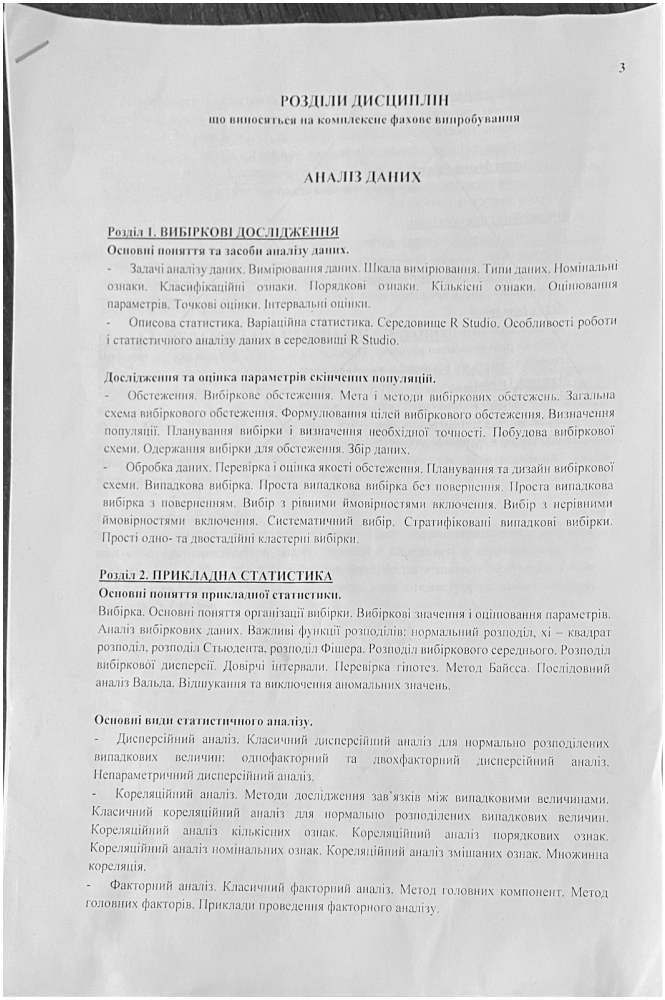

In [173]:
warped_img = getWarp(fixed, fixed_contour)
display(warped_img)

(1490, 570, 3)


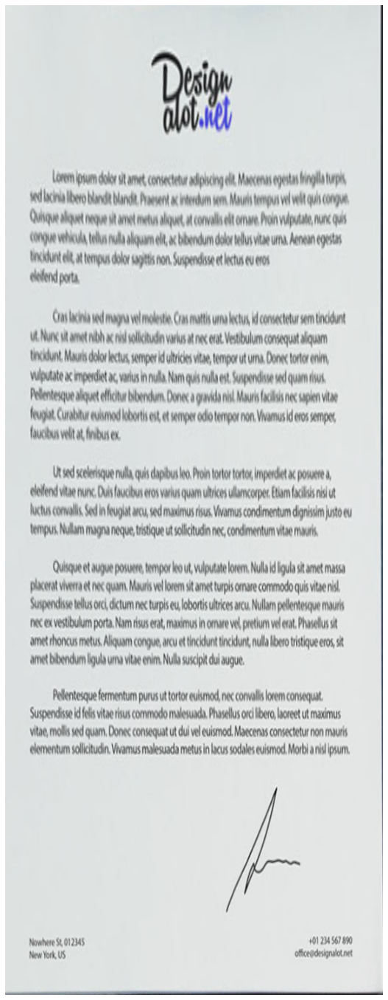

In [33]:
warped_img = getWarp(img, fixed_contour)
display(warped_img)